In [1]:
import warnings
warnings.filterwarnings("ignore")

import matplotlib.pyplot as plt
%matplotlib inline

import sys
import os

import numpy as np
import cv2

from keras.models import Model
from keras.layers import Input, Lambda
from keras.layers.normalization import BatchNormalization
from keras.layers.convolutional import UpSampling2D, Conv2D
from keras.layers.advanced_activations import LeakyReLU
from keras.layers import concatenate
from keras.optimizers import Adam
from keras import backend as K

from skimage.measure import compare_psnr

Using TensorFlow backend.


In [2]:
import numpy as np

import tensorflow
import keras

from keras.models import Sequential, Model
from keras.engine.input_layer import Input
from keras.layers import Dense, Conv2D, BatchNormalization, LeakyReLU, Lambda, Concatenate

# credit to: https://github.com/sabakanation/DeepImagePrior
def reflection_padding(x, padding):
    reflected = Lambda(lambda x: x[:, :, ::-1, :])(x)
    reflected = Lambda(lambda x: x[:, :, :padding[1], :])(reflected)
    upper_row = concatenate([x, reflected], axis=2)
    lower_row = Lambda(lambda x: x[:, ::-1, :, :])(upper_row)
    lower_row = Lambda(lambda x: x[:, :padding[0], :, :])(lower_row)
    padded = concatenate([upper_row, lower_row], axis=1)
    return padded

def get_layer_size(x):
    height, width = x.get_shape()[1:3]
    height = int(height)
    width = int(width)
    return [height, width]

def Conv_BN_Act(layer, num_channels=128, kernel_size=3, strides=(1,1)):
    size = get_layer_size(layer)

    padding = [0, 0]
    padding[0] = (int(size[0]/strides[0]) - 1) * strides[0] + kernel_size - size[0]
    padding[1] = (int(size[1]/strides[1]) - 1) * strides[1] + kernel_size - size[1]
    layer = reflection_padding(layer, padding)

    layer = Conv2D(num_channels, kernel_size, strides=strides, padding='valid', activation=None)(layer)
    layer = BatchNormalization()(layer)
    layer = LeakyReLU(alpha=0.2)(layer)

    return layer

# mostly based on: https://github.com/beala/deep-image-prior-tensorflow
def down_layer(layer, num_channels=128, kernel_size=3):
    size = get_layer_size(layer)
    if size[0] % 2 != 0:
        layer = reflection_padding(layer, [1, 0])
    if size[1] % 2 != 0:
        layer = reflection_padding(layer, [0, 1])

    layer = Conv_BN_Act(layer, num_channels, kernel_size, (2, 2))
    layer = Conv_BN_Act(layer, num_channels, kernel_size, (1, 1))
    
    return layer

def up_layer(layer, num_channels=128, kernel_size=3, inter="bilinear"):
    layer = UpSampling2D(size=(2, 2))(layer)

    if inter == "bilinear":
        layer_padded = reflection_padding(layer, (1, 1))
        layer = Lambda(lambda x: (x[:, :-1, 1:, :] + x[:, 1:, :-1, :] + x[:, :-1, :-1, :] + x[:, :-1, :-1, :]) / 4.0)(layer_padded)

    layer = Conv_BN_Act(layer, num_channels, kernel_size, (1, 1))
    layer = Conv_BN_Act(layer, num_channels, 1, (1, 1))
    
    return layer

def skip(layer, num_channels=4, kernel_size=1):
    layer = Conv_BN_Act(layer, num_channels, kernel_size, (1, 1))
    return layer

def build_model(input_shape, num_depth, down_channels, up_channels, down_kernel, up_kernel, skip_channel, skip_kernel, inter):
    input_layer = Input(shape=input_shape)

    # Connect up all the downsampling layers.
    skips = []
    layer = input_layer
    size = get_layer_size(layer)
    sizes = [size]
    for i in range(num_depth):
        layer = down_layer(layer, down_channels[i], down_kernel[i])
        size = get_layer_size(layer)
        sizes.append(size)
        if skip_channel[i] != 0:
            skips.append(skip(layer, skip_channel[i], skip_kernel[i]))
        else:
            skips.append(None)
    print("Shape after downsample: " + str(layer.get_shape()))

    # Connect up the upsampling layers, from smallest to largest.
    for i in range(num_depth-1, -1, -1):
        if skip_channel[i] != 0:
            layer = concatenate([layer, skips[i]], axis=3)
        layer = up_layer(layer, up_channels[i], up_kernel[i], inter)
        size = get_layer_size(layer)

        if sizes[i] != size:
            layer = Lambda(lambda x: x[:, :sizes[i][0], :sizes[i][1], :])(layer)

    print("Shape after upsample: " + str(layer.get_shape()))

    # Restore original image dimensions and channels
    output_layer = Conv2D(3, 1, strides=1, padding='valid', activation=None)(layer)
    print("Output shape: " + str(output_layer.get_shape()))
    
    model = Model(inputs=input_layer, outputs=output_layer)

    return model

In [23]:
def define_inpainting_model(height, width):
    input_shape = (height, width, 2)
    num_depth = 5
    up_channels = [128, 128, 128, 128, 128]
    down_channels = [128, 128, 128, 128, 128]
    up_kernel = [3, 3, 3, 3, 3]
    down_kernel = [3, 3, 3, 3, 3]
    skip_channel = [0, 0, 0, 0, 0]
    skip_kernel = [0, 0, 0, 0, 0]
    lr = 0.01
    inter = "bilinear"

    base_model = build_model(input_shape, num_depth, down_channels, up_channels, down_kernel, up_kernel, skip_channel, skip_kernel, inter)
    
    masked_image = Input(shape=(height, width, 3))
    mask_image = Input(shape=(height, width, 1))

    loss = Lambda(lambda x: K.sum(K.square((x[0] - x[1]) * x[2]), axis=-1))([base_model.output, masked_image, mask_image])

    model = Model([base_model.input, masked_image, mask_image], loss)
    model.compile(loss="mean_absolute_error", optimizer=Adam(lr=lr))

    return model, base_model


# def inpainting(masked_image, mask_image):
#     height, width = masked_image.shape[:2]
#     model, base_model = define_inpainting_model(height, width)

#     y = np.linspace(0.0, 1.0, height)
#     x = np.linspace(0.0, 1.0, width)
#     XX, YY = np.meshgrid(x, y)
#     input_meshgrid = np.concatenate([XX[:,:,None], YY[:,:,None]], axis=2)

#     for i in range(5000):
#         model.train_on_batch([input_meshgrid[None, :, :, :], masked_image[None, :, :, :], mask_image[None, :, :, None]], np.zeros((1, 320, 320)))

#     inpainted_image = np.clip(base_model.predict(input_meshgrid[None, :, :, :])[0], 0, 255).astype(np.uint8)
#     return (masked_image * mask_image[:, :, None] + inpainted_image * (1 - mask_image[:, :, None])).astype(np.uint8)



In [32]:
masked_name = 'data/inpainting/vase_masked.png'
mask_name = 'data/inpainting/vase_mask.png'
fname = 'data/inpainting/vase.png'
# inpainted_name = sys.argv[3]

image = cv2.imread(fname)
masked_image = cv2.imread(masked_name)
mask_image = cv2.imread(mask_name, cv2.IMREAD_GRAYSCALE) / 255.0
# inpainted_image = inpainting(masked_image, mask_image)
# cv2.imwrite(inpainted_name, inpainted_image)

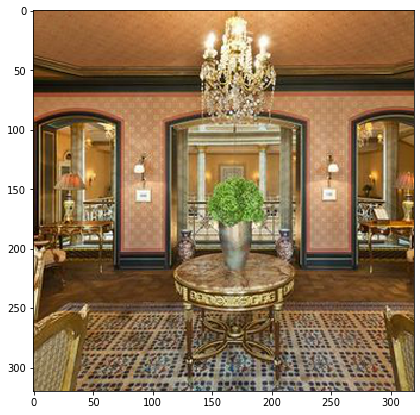

In [33]:
plt.figure(figsize=(7, 7))
plt.imshow(image[:,:,::-1])
plt.show()

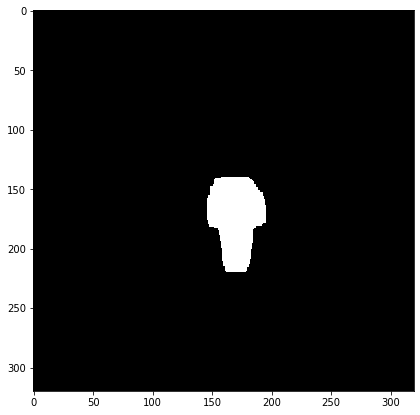

In [34]:
plt.figure(figsize=(7, 7))
plt.imshow(mask_image, cmap="Greys")
plt.show()

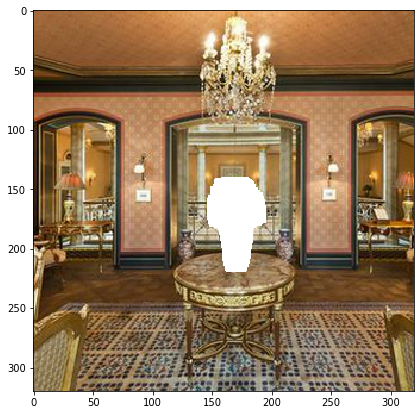

In [35]:
plt.figure(figsize=(7, 7))
plt.imshow(masked_image[:,:,::-1])
plt.show()

In [36]:
height, width = masked_image.shape[:2]
model, base_model = define_inpainting_model(height, width)

y = np.linspace(0.0, 1.0, height)
x = np.linspace(0.0, 1.0, width)
XX, YY = np.meshgrid(x, y)
input_meshgrid = np.concatenate([XX[:,:,None], YY[:,:,None]], axis=2)

Shape after downsample: (?, 10, 10, 128)
Shape after upsample: (?, 320, 320, 128)
Output shape: (?, 320, 320, 3)


In [37]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            (None, 320, 320, 2)  0                                            
__________________________________________________________________________________________________
lambda_213 (Lambda)             (None, 320, 320, 2)  0           input_7[0][0]                    
__________________________________________________________________________________________________
lambda_214 (Lambda)             (None, 320, 1, 2)    0           lambda_213[0][0]                 
__________________________________________________________________________________________________
concatenate_101 (Concatenate)   (None, 320, 321, 2)  0           input_7[0][0]                    
                                                                 lambda_214[0][0]                 
__________

In [38]:
base_model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            (None, 320, 320, 2)  0                                            
__________________________________________________________________________________________________
lambda_213 (Lambda)             (None, 320, 320, 2)  0           input_7[0][0]                    
__________________________________________________________________________________________________
lambda_214 (Lambda)             (None, 320, 1, 2)    0           lambda_213[0][0]                 
__________________________________________________________________________________________________
concatenate_101 (Concatenate)   (None, 320, 321, 2)  0           input_7[0][0]                    
                                                                 lambda_214[0][0]                 
__________

Iter # 0 , PSRN NOISY:  20.74643239682669 ; PSRN GT:  31.294615828883835


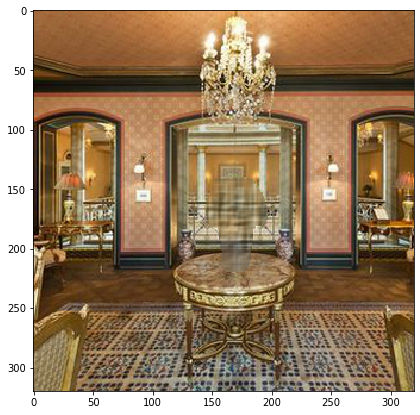

Iter # 20 , PSRN NOISY:  20.702268583087715 ; PSRN GT:  31.06947735635188


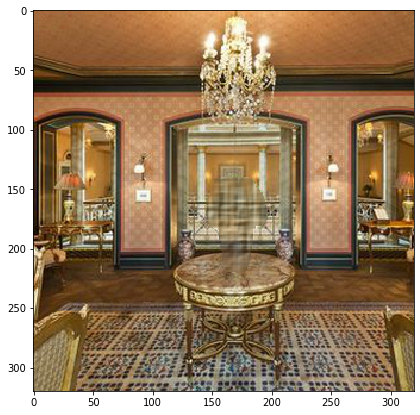

Iter # 40 , PSRN NOISY:  20.63366559735096 ; PSRN GT:  31.114000235740946


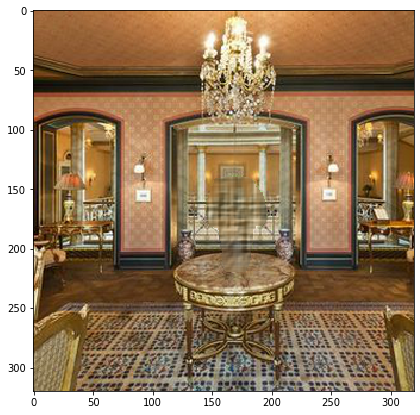

Iter # 60 , PSRN NOISY:  20.4954390960112 ; PSRN GT:  30.99197435119907


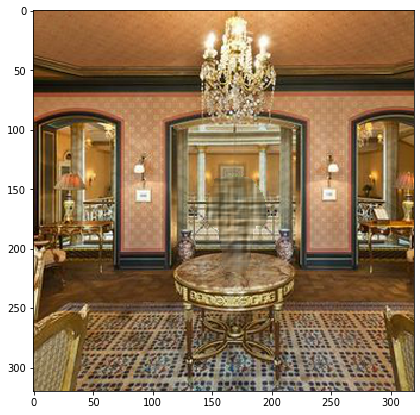

Iter # 80 , PSRN NOISY:  20.919988572156637 ; PSRN GT:  30.804822096709028


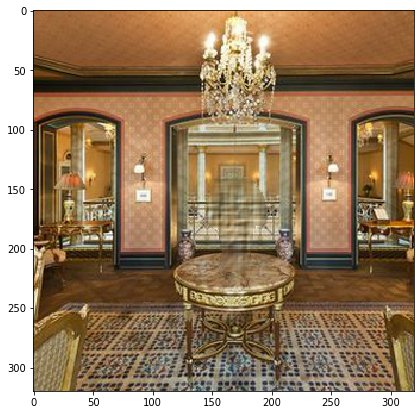

Iter # 100 , PSRN NOISY:  20.804617104070093 ; PSRN GT:  30.78915737197457


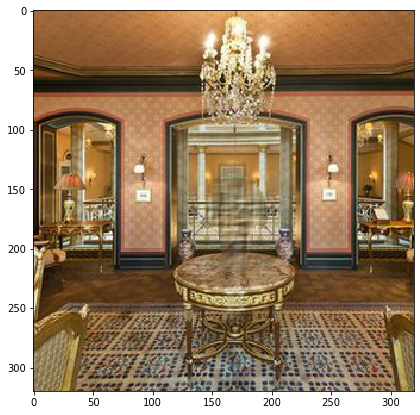

Iter # 120 , PSRN NOISY:  20.595043880812174 ; PSRN GT:  30.725507817838412


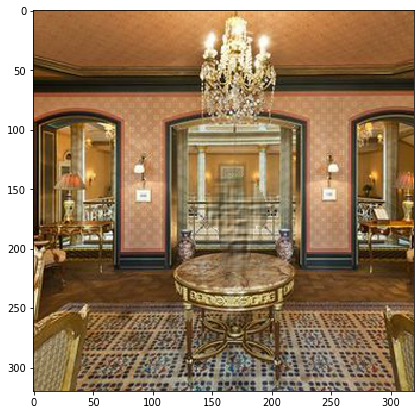

Iter # 140 , PSRN NOISY:  20.696178511200642 ; PSRN GT:  30.48191603169704


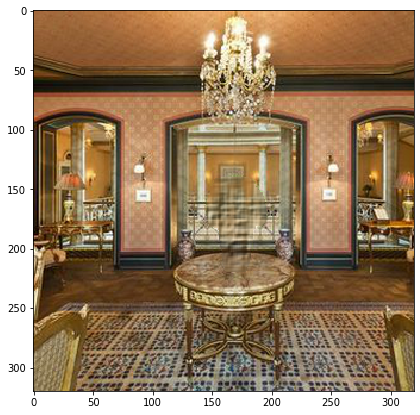

Iter # 160 , PSRN NOISY:  20.705716003582623 ; PSRN GT:  30.350909643439884


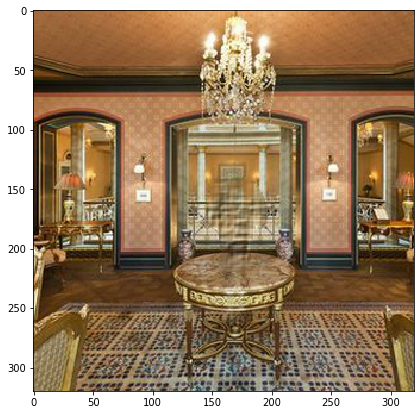

Iter # 180 , PSRN NOISY:  20.620853970468342 ; PSRN GT:  30.374811943199262


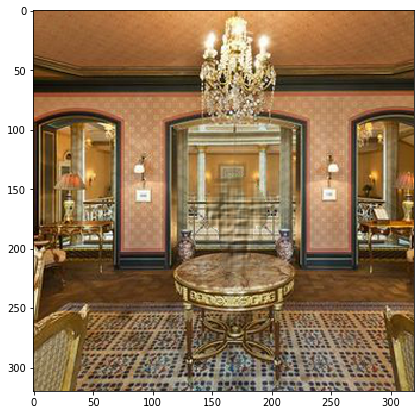

Iter # 200 , PSRN NOISY:  20.885162496120966 ; PSRN GT:  30.166007752328106


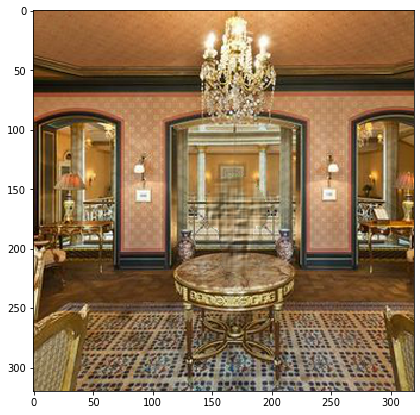

Iter # 220 , PSRN NOISY:  20.569077391810534 ; PSRN GT:  30.302675043238047


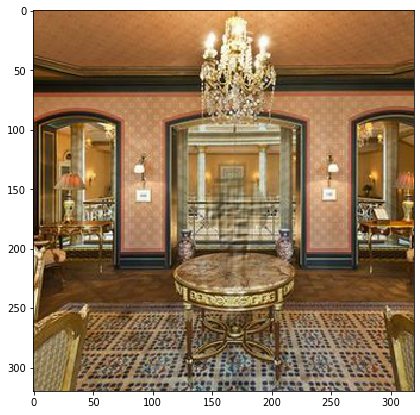

Iter # 240 , PSRN NOISY:  20.81117755819254 ; PSRN GT:  30.16808818105624


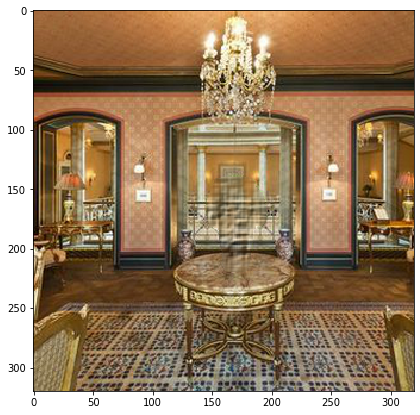

Iter # 260 , PSRN NOISY:  20.6736397853494 ; PSRN GT:  30.070238176747665


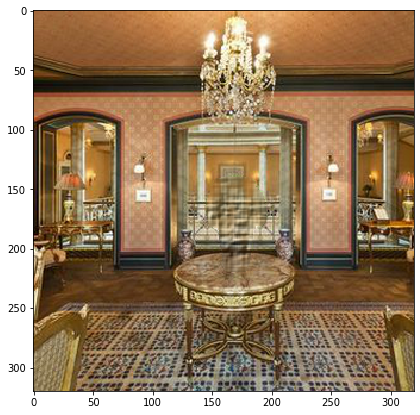

Iter # 280 , PSRN NOISY:  20.76773463898403 ; PSRN GT:  29.978766958022433


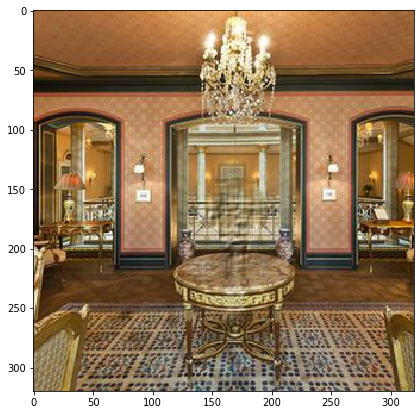

Iter # 300 , PSRN NOISY:  20.656050363732387 ; PSRN GT:  30.064611854096505


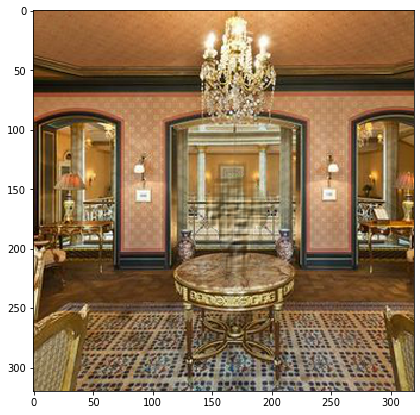

Iter # 320 , PSRN NOISY:  20.906071929403787 ; PSRN GT:  29.85575291041487


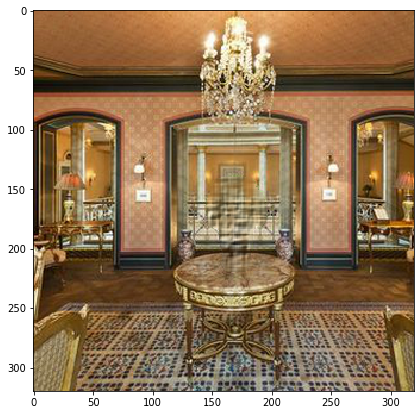

Iter # 340 , PSRN NOISY:  20.970888654475637 ; PSRN GT:  29.766015467345387


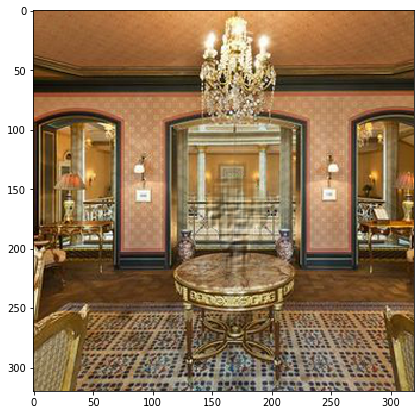

Iter # 360 , PSRN NOISY:  20.858898636481662 ; PSRN GT:  29.911074781985334


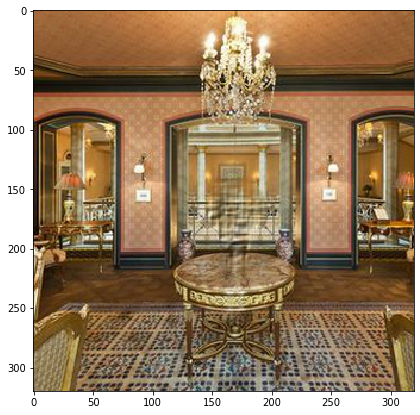

Iter # 380 , PSRN NOISY:  21.017954924723306 ; PSRN GT:  29.782837871864313


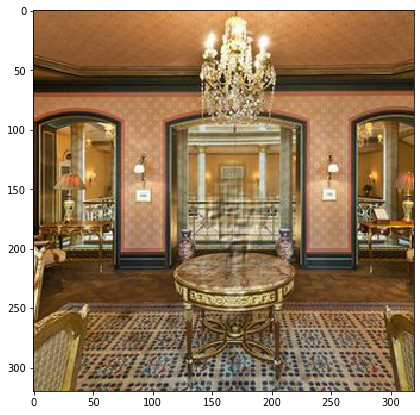

Iter # 400 , PSRN NOISY:  20.931880873875343 ; PSRN GT:  29.908238479018543


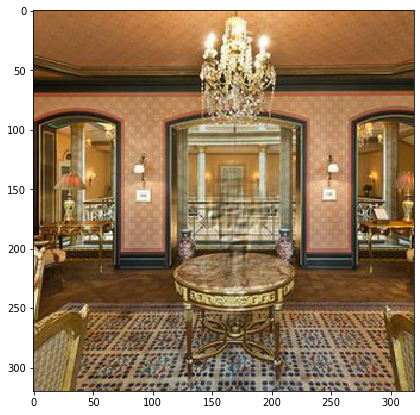

Iter # 420 , PSRN NOISY:  21.03680227478001 ; PSRN GT:  29.8766259025073


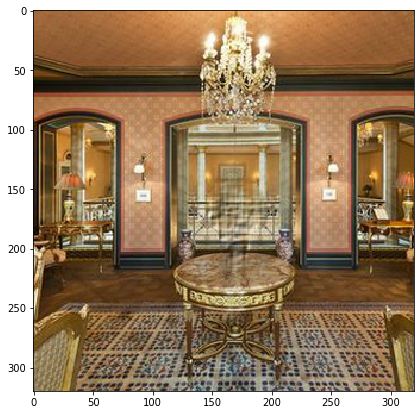

Iter # 440 , PSRN NOISY:  20.94312766106992 ; PSRN GT:  30.01193597888029


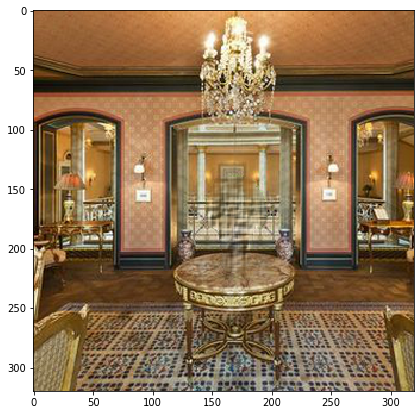

Iter # 460 , PSRN NOISY:  20.921302621723964 ; PSRN GT:  29.962204438253476


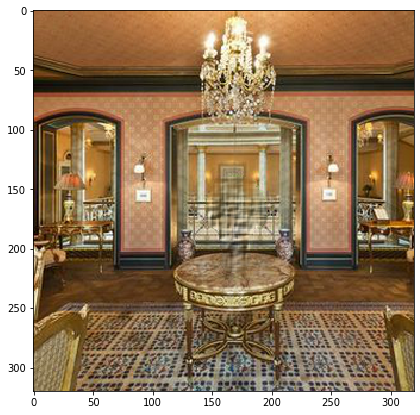

Iter # 480 , PSRN NOISY:  20.91257674218625 ; PSRN GT:  29.95779137980296


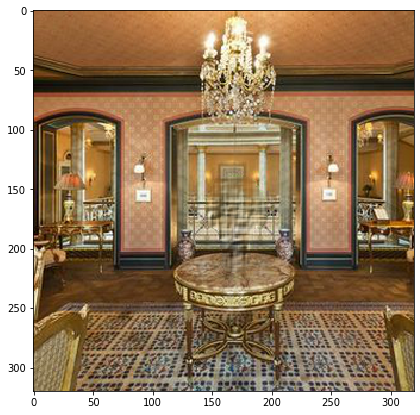

Iter # 500 , PSRN NOISY:  20.954342817671478 ; PSRN GT:  29.842033009193862


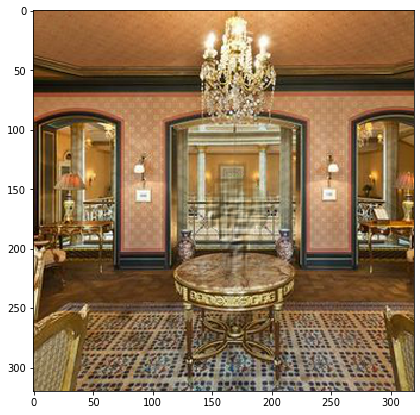

Iter # 520 , PSRN NOISY:  20.883409082387963 ; PSRN GT:  29.93268222845145


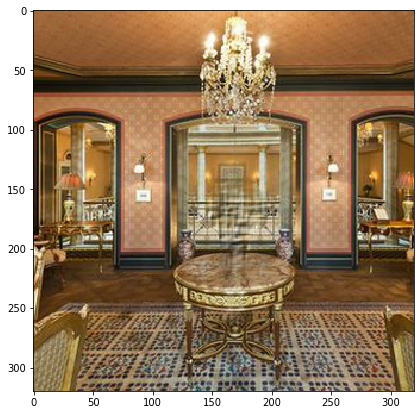

Iter # 540 , PSRN NOISY:  20.92684933646771 ; PSRN GT:  29.86981356815862


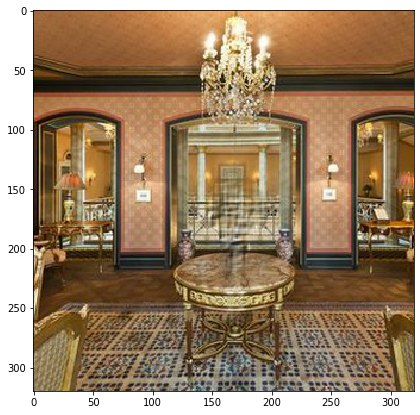

Iter # 560 , PSRN NOISY:  20.868897548423192 ; PSRN GT:  29.845256250371897


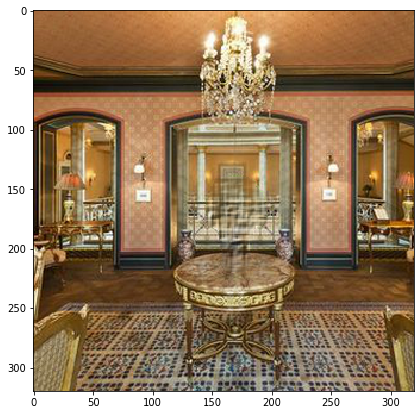

Iter # 580 , PSRN NOISY:  20.936994184935585 ; PSRN GT:  29.90114816433637


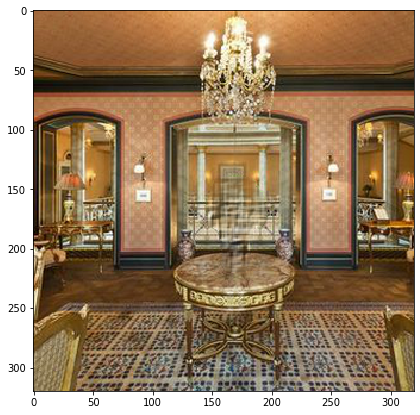

Iter # 600 , PSRN NOISY:  20.881753008182628 ; PSRN GT:  29.864830708555004


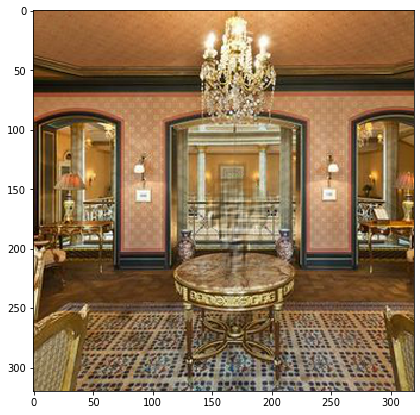

Iter # 620 , PSRN NOISY:  21.18143575805184 ; PSRN GT:  29.68523829948875


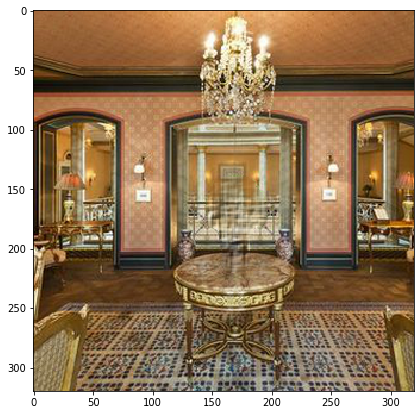

Iter # 640 , PSRN NOISY:  20.915937852179102 ; PSRN GT:  29.746822346890088


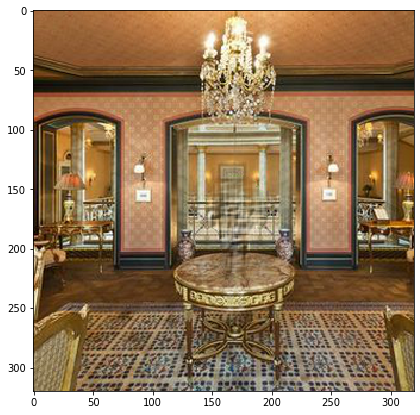

Iter # 660 , PSRN NOISY:  20.926251928221294 ; PSRN GT:  29.68068404676782


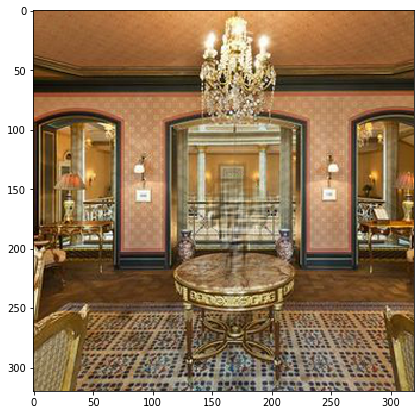

Iter # 680 , PSRN NOISY:  21.143392640269923 ; PSRN GT:  29.658988996899424


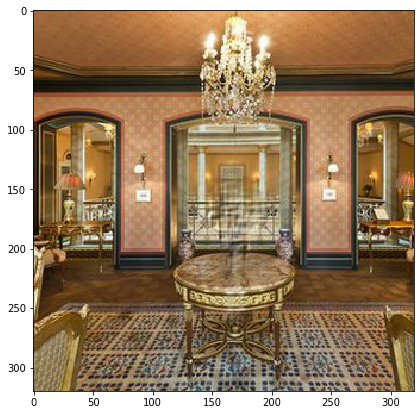

Iter # 700 , PSRN NOISY:  20.85615398419097 ; PSRN GT:  29.827456929335817


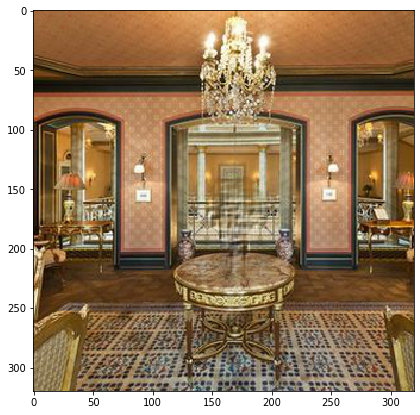

Iter # 720 , PSRN NOISY:  20.976332884320005 ; PSRN GT:  29.728284857854618


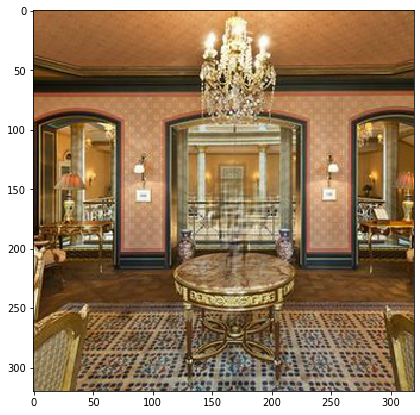

Iter # 740 , PSRN NOISY:  21.013557475412263 ; PSRN GT:  29.840945293677628


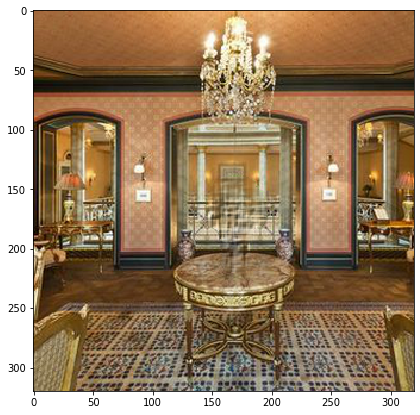

Iter # 760 , PSRN NOISY:  20.98999391395534 ; PSRN GT:  29.81534530228579


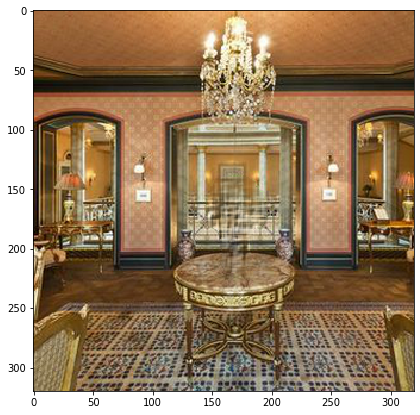

Iter # 780 , PSRN NOISY:  20.978729331523084 ; PSRN GT:  29.778993779227505


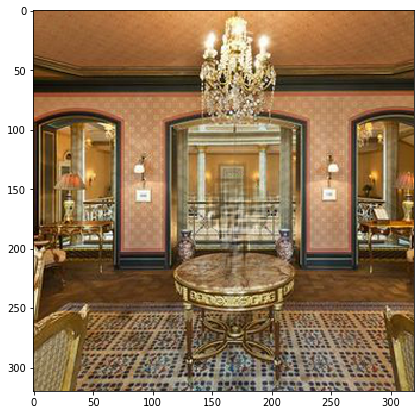

Iter # 800 , PSRN NOISY:  20.90027590495831 ; PSRN GT:  29.821752764155953


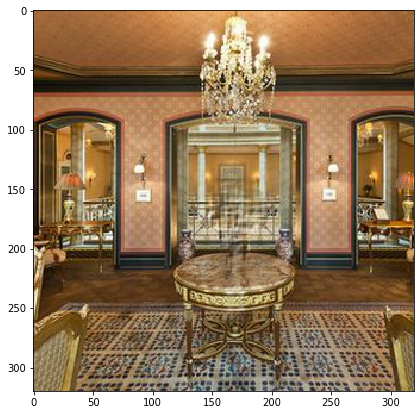

Iter # 820 , PSRN NOISY:  21.02887488229808 ; PSRN GT:  29.83469532119839


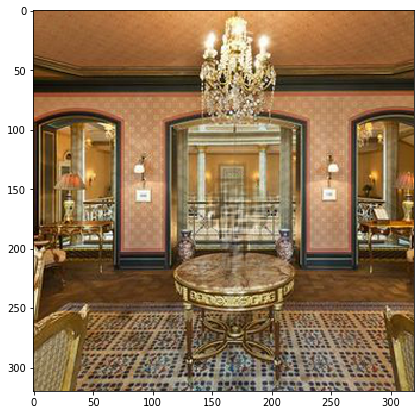

Iter # 840 , PSRN NOISY:  21.002274764492714 ; PSRN GT:  29.7138132322265


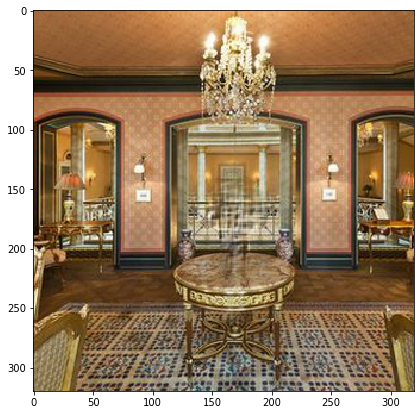

Iter # 860 , PSRN NOISY:  21.0575047813128 ; PSRN GT:  29.71524114348369


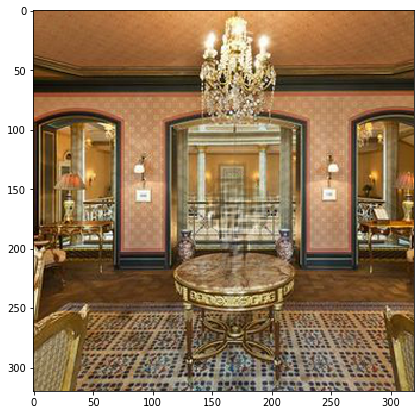

Iter # 880 , PSRN NOISY:  20.972803358634174 ; PSRN GT:  29.85458501081609


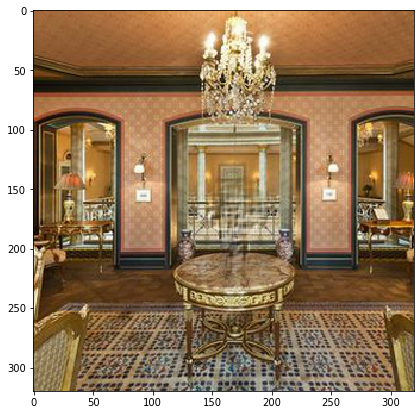

Iter # 900 , PSRN NOISY:  21.210096644039467 ; PSRN GT:  29.46872293454287


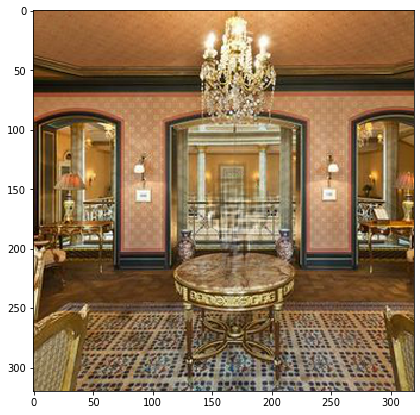

Iter # 920 , PSRN NOISY:  20.966558163795135 ; PSRN GT:  29.84324304330849


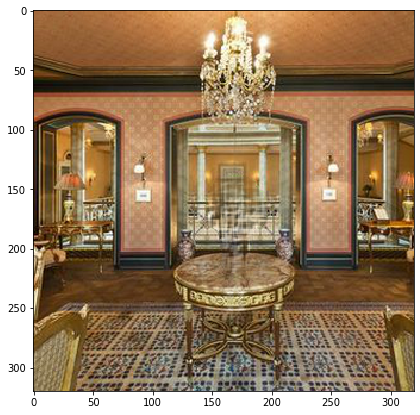

Iter # 940 , PSRN NOISY:  21.44963258350527 ; PSRN GT:  29.46930818734881


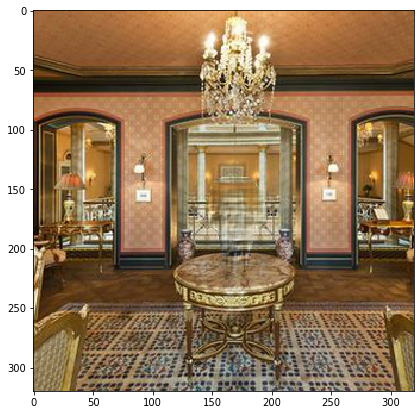

Iter # 960 , PSRN NOISY:  inf ; PSRN GT:  20.611145421508535


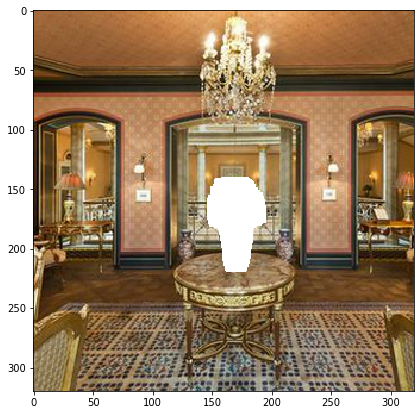

Iter # 980 , PSRN NOISY:  inf ; PSRN GT:  20.611145421508535


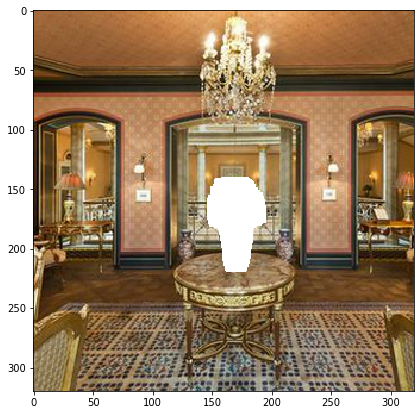

Iter # 1000 , PSRN NOISY:  inf ; PSRN GT:  20.611145421508535


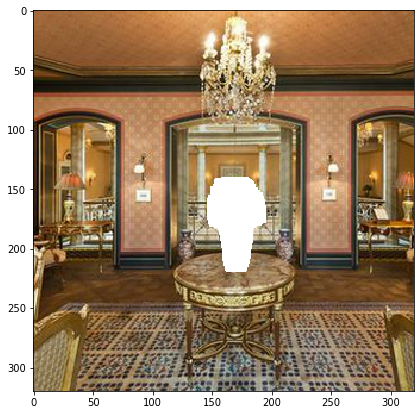

Iter # 1020 , PSRN NOISY:  inf ; PSRN GT:  20.611145421508535


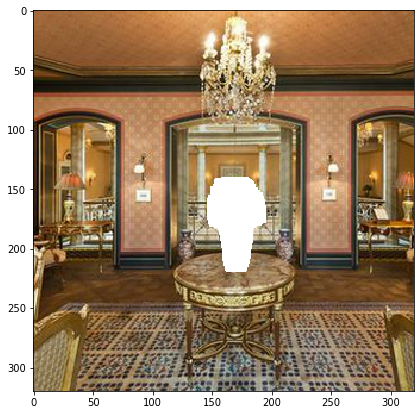

Iter # 1040 , PSRN NOISY:  35.39590782133062 ; PSRN GT:  21.13487477742625


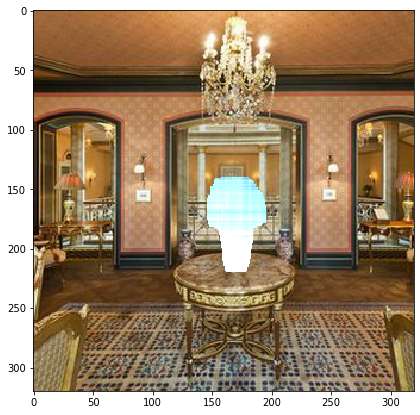

Iter # 1060 , PSRN NOISY:  26.35993637623393 ; PSRN GT:  23.848541753013865


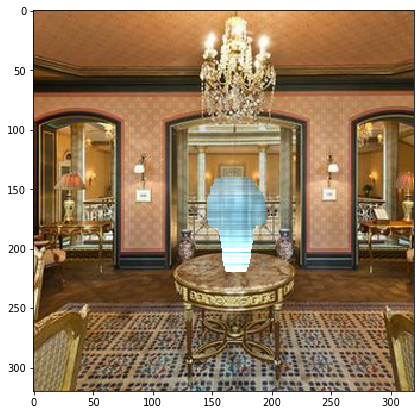

Iter # 1080 , PSRN NOISY:  23.272612370639397 ; PSRN GT:  26.991262100569898


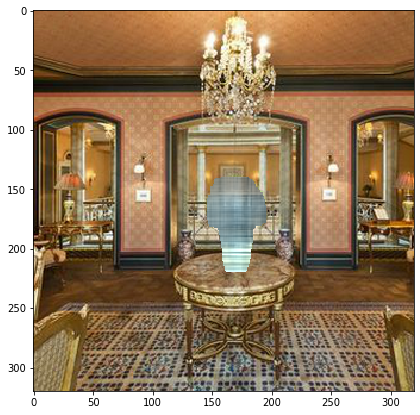

Iter # 1100 , PSRN NOISY:  21.57310296808511 ; PSRN GT:  28.973318223566466


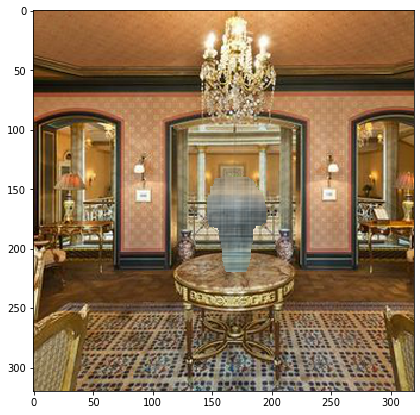

Iter # 1120 , PSRN NOISY:  21.592057795951362 ; PSRN GT:  29.34060290962751


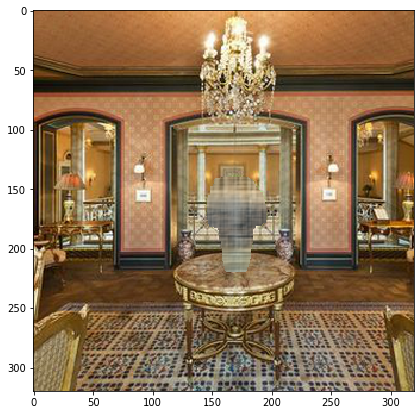

Iter # 1140 , PSRN NOISY:  21.58038886101343 ; PSRN GT:  30.09243374388584


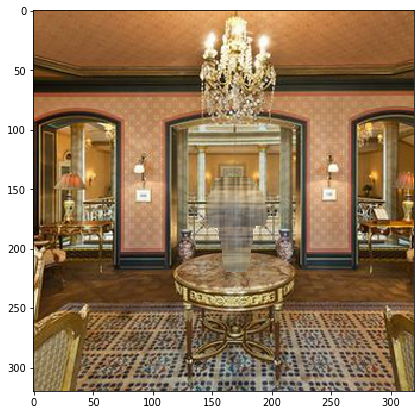

Iter # 1160 , PSRN NOISY:  21.43137581358794 ; PSRN GT:  30.19954045146497


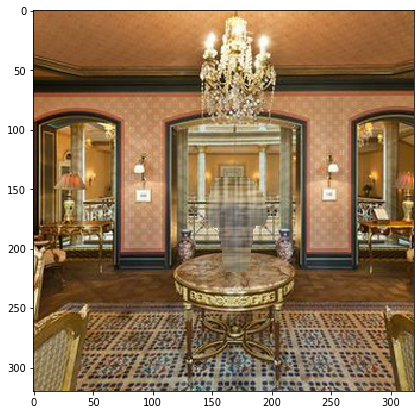

Iter # 1180 , PSRN NOISY:  21.39259863218253 ; PSRN GT:  30.78748794923161


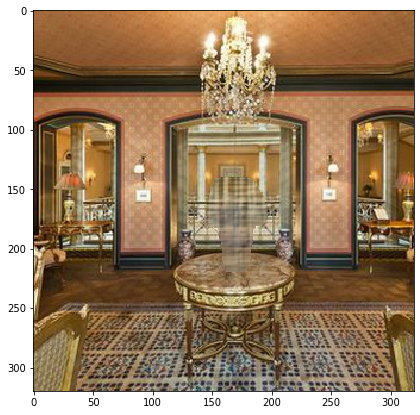

In [41]:
for i in range(2000):
    model.train_on_batch([input_meshgrid[None, :, :, :], masked_image[None, :, :, :], mask_image[None, :, :, None]], np.zeros((1, 320, 320)))
    
    if i % 20 == 0:
        inpainted_image = np.clip(base_model.predict(input_meshgrid[None, :, :, :])[0], 0, 255).astype(np.uint8)
        out = (masked_image * mask_image[:, :, None] + inpainted_image * (1 - mask_image[:, :, None])).astype(np.uint8)
        cv2.imwrite("v3_inp_inpainted_image_"+str(i)+".png", inpainted_image)
        cv2.imwrite("v3_inp_out_"+str(i)+".png", out)
        
        psrn_noisy = compare_psnr(masked_image, out) 
        psrn_gt = compare_psnr(image, out)
        print("Iter #", i, ", PSRN NOISY: ", psrn_noisy, "; PSRN GT: ", psrn_gt)
        
        plt.figure(figsize=(7, 7))
        plt.imshow(out[:,:,::-1])
        plt.show()



In [40]:
model.save("model_inp.h5")
base_model.save("base_model_inp.h5")